In [90]:

import pandas as pd
import numpy as np
from tqdm import tqdm
import os
import requests
from sklearn.metrics import precision_recall_fscore_support

In [91]:
val_zaragoza = pd.read_excel("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/admin_eval_task/validacion_objeto.xlsx").dropna()
val_zaragoza

,Columna 1,metadata,raw_textc,objective,in_text_score,Validación,Observaciones,Column1
93,93,"{'author': '', 'creationDate': ""D:202410011255...",1. LUIS JOSE MANSO ZÚÑIGA GONZÁLEZ – JEFE DE L...,The task involves providing real-time video in...,0.0,Incorrecto,Regular la adquisición y suministro de tres (3...,no está en el texto extraído
103,103,"{'author': '', 'creationDate': ""D:202307131220...",23–021–AHÍ FILM MOLINER RESTAURACIÓN ZÓCALO–P1...,OBJETO DEL PLIEGO GENERAL,1.0,Incorrecto,OBJETO EN MEMORIA: El objeto principal del pre...,"No aparece, meter limitación si corot"


In [92]:
val_zaragoza["Validación"].value_counts()
# obtain accuracy of "Validación" column
val_zaragoza["Validación"].value_counts(normalize=True)

Validación
Incorrecto    1.0
Name: proportion, dtype: float64

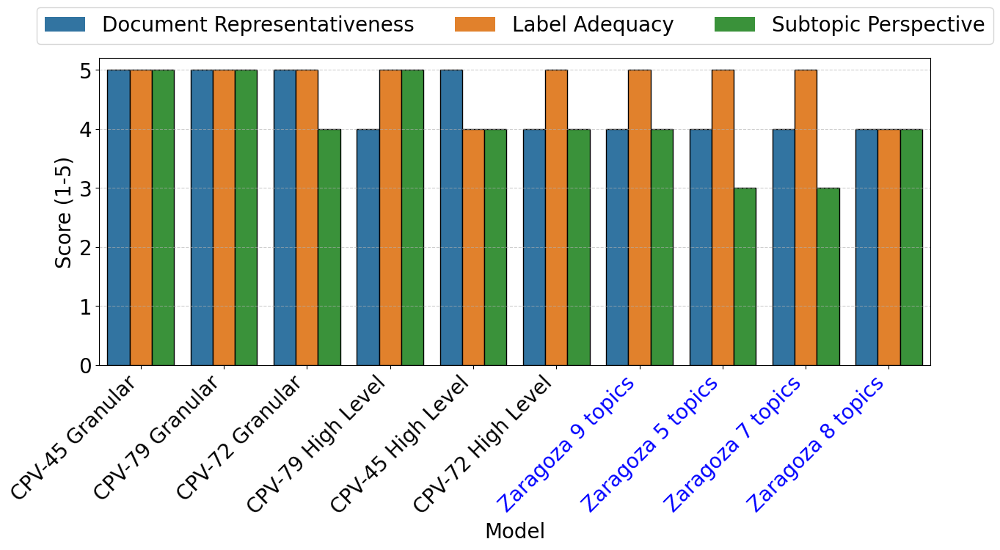

In [93]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Data
data = {
    "Model": [
        "CPV-45 Granular", "CPV-45 High Level", "CPV-79 Granular", "CPV-79 High Level",
        "CPV-72 Granular", "CPV-72 High Level", "Zaragoza 5 topics", "Zaragoza 7 topics", "Zaragoza 8 topics", "Zaragoza 9 topics", 
    ],
    "Subtopic Perspective": [5, 4, 5, 5, 4, 4, 3, 3, 4, 4],
    "Label Adequacy": [5, 4, 5, 5, 5, 5, 5, 5, 4, 5],
    "Document Representativeness": [5, 5, 5, 4, 5, 4, 4, 4, 4, 4],
}

# Create DataFrame
df = pd.DataFrame(data)

# Add average score column
df["Average"] = df.iloc[:, 1:].mean(axis=1)
df = df.sort_values(by="Average", ascending=False)

# Melt DataFrame for visualization
df_melted = df.melt(
    id_vars=["Model"], 
    value_vars=["Document Representativeness", "Label Adequacy", "Subtopic Perspective"], 
    var_name="Criterion", 
    value_name="Score"
)

# Plot
plt.figure(figsize=(14, 8))  # Consistent figure size
sns.barplot(data=df_melted, x="Model", y="Score", hue="Criterion", dodge=True)

# Customize plot
plt.xticks(rotation=45, ha="right", fontsize=20)  # Consistent font size for xticks
plt.yticks(fontsize=20)  # Consistent font size for yticks
plt.ylabel("Score (1-5)", fontsize=20)  # Consistent font size for ylabel
plt.xlabel("Model", fontsize=20)  # Consistent font size for xlabel
plt.ylim(0, 5.2)

# Adjust legend to avoid overlap
plt.legend(
    loc='upper center', 
    bbox_to_anchor=(0.5, 1.2),  # Move legend higher above the graph
    shadow=False, 
    ncol=3, 
    fontsize=20  # Consistent font size for legend
)

# Highlight Zaragoza models
ax = plt.gca()
for label in ax.get_xticklabels():
    if label.get_text().startswith("Zaragoza"):
        label.set_color("blue")

# Add border to bars
for bar in ax.patches:
    bar.set_edgecolor("black")

# Add grid and layout adjustments
plt.grid(axis="y", linestyle="--", alpha=0.6)
plt.tight_layout()

# Remove or update tick_params to match the font size
plt.tick_params(axis='both', which='major', labelsize=20)  # Updated to match xticks and yticks font size

# Show plot
plt.show()

In [94]:
def load_parquet_into_one(input_folder):
    dfs = []
    for file_name in tqdm(os.listdir(input_folder)):
        if file_name.endswith(".parquet"):
            file_path = os.path.join(input_folder, file_name)
            df = pd.read_parquet(file_path)
            dfs.append(df)    
    return pd.concat(dfs, ignore_index=True) 

In [95]:
import langid

def langDetect(row):
    try:
        lang, _ = langid.classify(row.objective.replace("\n", ""))
    except Exception:
        lang = "unknown"
    return lang

In [96]:
def get_original_objective(expediente):
    url = f"https://www.zaragoza.es/sede/servicio/contratacion-publica/contrato.json?expediente={expediente}&fl=objeto"    
    try:
        response = requests.get(url, timeout=10)  
        response.raise_for_status()  
        
        data = response.json()
        #print(data)
        if "result" in data and 'objeto' in data["result"][0]:
            #object = data["result"][0]["objeto"]
            #print(f"Expediente {expediente} - Object: {object}")
            return data["result"][0]["objeto"]
        else:
            return None  

    except requests.exceptions.RequestException as e:
        print(f"Error fetching expediente {expediente}: {e}")
        return None

In [97]:
import pandas as pd
import numpy as np
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity

model = SentenceTransformer("paraphrase-multilingual-MiniLM-L12-v2")

def compute_similarity(row, col1, col2):
    text1, text2 = row[col1], row[col2]
    
    if pd.notna(text1) and pd.notna(text2):  # Ensure both are not None
        emb1 = model.encode([text1])[0]
        emb2 = model.encode([text2])[0]
        similarity = cosine_similarity([emb1], [emb2])[0][0]
        return similarity
    return np.nan  # If any value is None, return NaN

def add_similarity_column(df, col1, col2, new_col="similarity"):
    df[new_col] = df.apply(lambda row: compute_similarity(row, col1, col2), axis=1)
    return df

/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/.venv/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [98]:
def get_final_objective_label(row, thr=0.2):
    if row.objective == "/" or row.lang_objective == "en" or (row.similarity < thr):
        return 0
    else:
        return 1

## Find threshold for keeping objectives

In [99]:
df = pd.read_excel("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/admin_eval_task/curated_objectvies/zaragoza_objectives_to_review.xlsx").dropna(subset=["label"])
df[["similarity", "label"]]

,similarity,label
0,0.938665,1.0
1,0.817065,1.0
2,0.856878,1.0
3,0.308914,0.0
5,0.766396,1.0
...,...,...
215,0.161573,0.0
216,0.656287,0.0
217,0.661638,1.0
218,0.781334,0.0


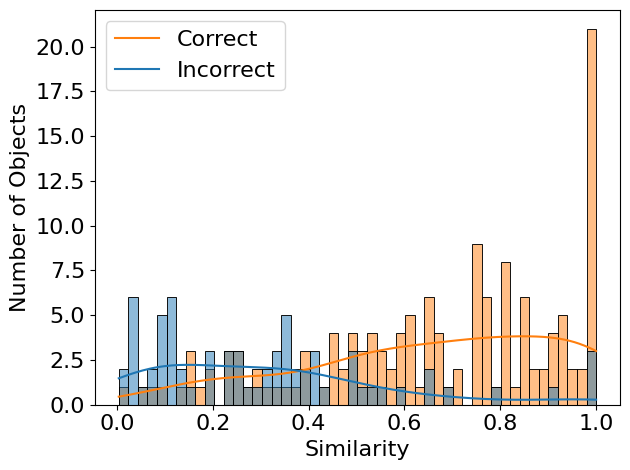

In [101]:
# Plot similarity distribution vs label
import matplotlib.pyplot as plt
import seaborn as sns

# Plot histogram
sns.histplot(df, x="similarity", hue="label", bins=50, kde=True)

# Update legend
plt.legend(labels=["Correct", "Incorrect"], fontsize=16)  # Translated and updated font size
plt.xlabel("Similarity", fontsize=16)  # Translated and updated font size
plt.ylabel("Number of Objects", fontsize=16)  # Translated and updated font size

# Update tick sizes
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

# Show plot
plt.tight_layout()
plt.show()

In [15]:

thresholds = np.linspace(min(df["similarity"]), max(df["similarity"]), 100)

results = []
for threshold in thresholds:
    predictions = (df["similarity"] >= threshold).astype(int)
    
    precision, recall, f1, _ = precision_recall_fscore_support(df["label"], predictions, average="binary")
    
    results.append((threshold, precision, recall, f1))

results_df = pd.DataFrame(results, columns=["Threshold", "Precision", "Recall", "F1-Score"])


print(f"Threshold with max F1-Score: {results_df[results_df['F1-Score'] == results_df['F1-Score'].max()]['Threshold'].values[0]}; METRICS (Precision / Recall / F1): {results_df[results_df['F1-Score'] == results_df['F1-Score'].max()].drop(columns=['Threshold']).values[0]}")
print(f"Threshold with max Precision: {results_df[results_df['Precision'] == results_df['Precision'].max()]['Threshold'].values[0]}; METRICS (Precision / Recall / F1):{results_df[results_df['Precision'] == results_df['Precision'].max()].drop(columns=['Threshold']).values[0]}")

metric = "F1-Score"
final_thr = results_df[results_df[metric] == results_df[metric].max()]["Threshold"].values[0]

Threshold with max F1-Score: 0.4364907985383816; METRICS (Precision / Recall / F1): [0.88461538 0.80985915 0.84558824]
Threshold with max Precision: 0.6981201259927319; METRICS (Precision / Recall / F1):[0.93421053 0.5        0.65137615]


## Create final dataset for training based on extracted objectives

In [16]:
def load_parquet_into_one(input_folder):
    dfs = []
    for file_name in tqdm(os.listdir(input_folder)):
        if file_name.endswith(".parquet"):
            file_path = os.path.join(input_folder, file_name)
            df = pd.read_parquet(file_path)
            dfs.append(df)    
    return pd.concat(dfs, ignore_index=True) 

### PLACE INFO

In [17]:
df_place = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/sproc/place_feb_21/place_all_embeddings_metadata.parquet")

In [18]:
df_place

,id,place_id,origin,expedient,objective,cpv,nuts,org_loc,budget,date,place_date,link,raw_text,lemmas,embeddings
0,0,https://contrataciondelestado.es/sindicacion/P...,out,2019_213,L'objecte d'aquest encàrrec per part del CONSO...,None,ES512,Entitats de l'administració local,NaN,nan,[nan],https://contractaciopublica.cat/ca/detall-publ...,L'objecte d'aquest encàrrec per part del CONSO...,consorci_vies verdes_girona tragsa conservació...,-0.23268852 -0.2679665 -0.072283626 -0.1170956...
1,1,https://contrataciondelestado.es/sindicacion/l...,ins,DCG-307/2019,Proyecto De Adecuación De Oficinas De Los Serv...,[45000000.0],ES300,Aena. Dirección de Contratación,NaN,nan,[nan],https://contrataciondelestado.es/wps/poc?uri=d...,Proyecto De Adecuación De Oficinas De Los Serv...,proyecto adecuación oficinas servicios_central...,-0.02814787 -0.13409117 -0.06640905 -0.0788602...
2,2,https://contrataciondelestado.es/sindicacion/l...,ins,MAD-136/2019,Plan De Obsolescencia Sai´S T123 Fase i,[31000000.0],ES300,Aena. Dirección del Aeropuerto de Madrid-Baraj...,NaN,nan,[nan],https://contrataciondelestado.es/wps/poc?uri=d...,Plan De Obsolescencia Sai´S T123 Fase i,plan obsolescencia fase,-0.23452374 0.23028997 0.18730758 -0.19488867 ...
3,3,https://contrataciondelestado.es/sindicacion/l...,ins,20194089-V,Contrato de suministro para la adquisición del...,[18100000.0],ES3,<NA>,NaN,nan,[nan],https://contrataciondelestado.es/wps/poc?uri=d...,Contrato de suministro para la adquisición del...,suministro adquisición vestuario equipo protec...,-0.12146915 0.13177831 -0.066414416 0.2246932 ...
4,4,https://contrataciondelestado.es/sindicacion/l...,ins,07/19,Mediación de Riesgos y Seguros.,[66000000.0],ES620,<NA>,NaN,nan,[nan],https://contrataciondelestado.es/wps/poc?uri=d...,Mediación de Riesgos y Seguros.,mediación_riesgos seguros,-0.020959144 0.1747884 -0.2840229 0.052032873 ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3827743,3827743,https://contrataciondelestado.es/sindicacion/l...,ins,01/18,Suministro de material de oficina básico con d...,[30197000.0],ES30,<NA>,53146.0,0018-03-02,"[['0018-03-02', '0018-03-02', '2018-03-20'], [...",https://contrataciondelestado.es/wps/poc?uri=d...,Suministro de material de oficina básico con d...,suministro material oficina básico destino alm...,0.053728275 0.033718243 0.010642192 0.06366115...
3827744,3827744,https://contrataciondelestado.es/sindicacion/P...,out,A2018/000249,Explotación de la cafetería-restaurante y serv...,[55300000.0],ES413,<NA>,54964.8,0002-12-02,"[['0002-12-02', '2017-12-29', '2017-12-29']]",https://contratacion.jcyl.es/web/jcyl/Contrata...,Explotación de la cafetería-restaurante y serv...,explotación servicio comedor usuario servicio ...,0.19895372 -0.22709867 -0.14535315 0.14950758 ...
3827745,3827745,https://contrataciondelestado.es/sindicacion/P...,out,A2018/000262,Explotación de la cafetería-restaurante y serv...,[55300000.0],ES413,<NA>,54964.8,0002-12-02,"[['0002-12-02', '2017-12-27', '2017-12-27']]",https://contratacion.jcyl.es/web/jcyl/Contrata...,Explotación de la cafetería-restaurante y serv...,explotación servicio comedor usuario servicio ...,0.18068197 -0.22375913 -0.15644608 0.17646262 ...
3827746,3827746,https://contrataciondelestado.es/sindicacion/P...,out,D2018/001233,Suministro de gas natural canalizado en divers...,[9123000.0],ES41,<NA>,255500.0,0002-12-02,"[['0002-12-02', '2018-03-20', '2018-03-21']]",https://contratacion.jcyl.es/web/jcyl/Contrata...,Suministro de gas natural canalizado en divers...,suministro natural_canalizado centros consejer...,0.051175013 -0.06626684 -0.016259827 0.0174854...


### ALL / GENCAT

In [19]:
df_df_gencat = pd.read_parquet("/export/data_ml4ds/NextProcurement/PLACE/pliegos_objectives/all_extracted_31_oct_es_translated_with_place_id_created24feb_merge_with_place.parquet")

In [20]:
df_place_complete = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/sproc/place_feb_21/place_all_embeddings_metadata.parquet")

In [21]:
df_df_gencat = df_df_gencat.merge(df_place_complete[["place_id", "link"]], on="place_id", how="left")

In [22]:
# find duplicates

duplicados = df_df_gencat[df_df_gencat.duplicated(subset=['place_id'], keep=False)][["place_id", "procurement_id", "link", "objective"]]
diferencias = duplicados.groupby('place_id').agg(lambda x: ', '.join(map(str, x.unique())))


In [23]:
diferencias

,procurement_id,link,objective
place_id,,,
https://contrataciondelestado.es/sindicacion/PlataformasAgregadasSinMenores/10000714,"ntp00297171, ntp00295364",https://contractaciopublica.gencat.cat/ecofin_...,La alimentación sostenible: Manual de ciudades...
https://contrataciondelestado.es/sindicacion/PlataformasAgregadasSinMenores/10000716,"ntp00339915, ntp00301923",https://www.bilbao.eus/cs/Satellite?LicitAyu=s...,Adquisición de un Vehículo Auto-Escalera Girat...
https://contrataciondelestado.es/sindicacion/PlataformasAgregadasSinMenores/10000733,"ntp00295193, ntp00298848",https://contractaciopublica.gencat.cat/ecofin_...,La Unión de Cooperadores de Gava es un edifici...
https://contrataciondelestado.es/sindicacion/PlataformasAgregadasSinMenores/10000734,"ntp00330377, ntp00291649, ntp00309076, ntp0033...",https://www.contratacion.euskadi.eus/w32-kpepe...,El objeto del presente pliego es definir las p...
https://contrataciondelestado.es/sindicacion/PlataformasAgregadasSinMenores/10000748,"ntp00287558, ntp00300615",https://contractaciopublica.gencat.cat/ecofin_...,El objeto del contrato es la instalación y pos...
...,...,...,...
https://contrataciondelestado.es/sindicacion/licitacionesPerfilContratante/996083,"ntp00438438, ntp00532067",https://contrataciondelestado.es/wps/poc?uri=d...,El objeto del presente pliego es la contrataci...
https://contrataciondelestado.es/sindicacion/licitacionesPerfilContratante/996569,"ntp00443574, ntp00538818",https://contrataciondelestado.es/wps/poc?uri=d...,El objeto del contrato consiste en la prestaci...
https://contrataciondelestado.es/sindicacion/licitacionesPerfilContratante/9966458,"ntp01071050, ntp01027930",https://contrataciondelestado.es/wps/poc?uri=d...,El licitador que resulte adjudicatario del Con...


In [24]:
df_df_gencat[df_df_gencat["procurement_id"] == "ntp00297171"]

,doc_name,translated,extracted,clean_extracted,lang,objective,in_text_score,processed_0,processed_1000,processed_2000,...,ContractFolderStatus.ProcurementProject.RealizedLocation.CountrySubentityCode,ContractFolderStatus.LocatedContractingParty.ParentLocatedParty.PartyName.Name,ContractFolderStatus.ProcurementProject.BudgetAmount.EstimatedOverallContractAmount,ContractFolderStatus.TenderResult.SMEAwardedIndicator,ContractFolderStatus.ContractFolderID,title,ContractFolderStatus.ValidNoticeInfo.AdditionalPublicationStatus.AdditionalPublicationDocumentReference.IssueDate,origin,similarity,link
398348,ntp00297171_Pliego_Prescripciones_tecnicas_URI,yes,"1.- INTRODUCCIÓN Barcelona trabaja, desde hace...",None,None,La alimentación sostenible: Manual de ciudades...,1.0,True,True,True,...,ES511,Entitats municipals de Catalunya,99630.55,None,001/22001064,l'organització d'una fira d'alimentació sosten...,"[['2022-05-13', '2022-07-01', '2022-07-07']]",out,0.549378,https://contractaciopublica.gencat.cat/ecofin_...


In [25]:
df_df_gencat[df_df_gencat["procurement_id"] == "ntp00295364"]

,doc_name,translated,extracted,clean_extracted,lang,objective,in_text_score,processed_0,processed_1000,processed_2000,...,ContractFolderStatus.ProcurementProject.RealizedLocation.CountrySubentityCode,ContractFolderStatus.LocatedContractingParty.ParentLocatedParty.PartyName.Name,ContractFolderStatus.ProcurementProject.BudgetAmount.EstimatedOverallContractAmount,ContractFolderStatus.TenderResult.SMEAwardedIndicator,ContractFolderStatus.ContractFolderID,title,ContractFolderStatus.ValidNoticeInfo.AdditionalPublicationStatus.AdditionalPublicationDocumentReference.IssueDate,origin,similarity,link
404024,ntp00295364_Pliego_Prescripciones_tecnicas_URI,yes,"1.- INTRODUCCIÓN Barcelona trabaja, desde hace...",None,None,La alimentación sostenible: Manual de ciudades...,1.0,True,True,True,...,ES511,Entitats municipals de Catalunya,99630.55,None,001/22001064,l'organització d'una fira d'alimentació sosten...,"[['2022-05-13', '2022-07-01', '2022-07-07']]",out,0.549378,https://contractaciopublica.gencat.cat/ecofin_...


### ZARAGOZA

In [26]:
zaragoza_path = "/export/data_ml4ds/NextProcurement/temporal/objectives_extracted"
zaragoza_path_v2 = "/export/data_ml4ds/NextProcurement/temporal/objectives_extracted_v2"
zaragoza_path_original = "/export/data_ml4ds/NextProcurement/temporal/objectives_extracted_original"

df_zaragoza = load_parquet_into_one(zaragoza_path_original)

# lang detection
df_zaragoza["lang_objective"] = df_zaragoza.apply(langDetect, axis=1)
# get original objective (PLACE metadata)
df_zaragoza['expediente'] = df_zaragoza['pdf_path'].apply(lambda x: x.split("/")[-2])
df_zaragoza['orig_objective'] = df_zaragoza['expediente'].apply(get_original_objective)
# compute similarity
df_zaragoza_original = add_similarity_column(df_zaragoza, "objective", "orig_objective")

# read complete place data
#df_place = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/sproc/place_feb_21/place_all_embeddings_metadata.parquet")


# rename "objective" to "title" and keep only "place_id", "link", "title", "origin", "expedient"
df_place = df_place.rename(columns={"objective": "title"})

100%|██████████| 7/7 [00:03<00:00,  1.93it/s]


In [27]:
df_place = df_place[["place_id", "link", "title", "origin", "date", "expedient", "cpv"]]

# merge zaragoza data with place data (on "expediente" from zaragoza and "expedient" from place)
df_zaragoza = df_zaragoza.merge(df_place, how="left", left_on="expediente", right_on="expedient")
df_zaragoza

,pdf_id,metadata,raw_text,raw_textc,pdf_path,json_path,summary,objective,in_text_score,processed_0,...,expediente,orig_objective,similarity,place_id,link,title,origin,date,expedient,cpv
0,1,"{'author': '', 'creationDate': 'D:201902121143...",PROYECTO RENOVACIÓN DEL ALUMBRADO PÚBLICO Y M...,PROYECTO RENOVACIÓN DEL ALUMBRADO PÚBLICO Y ME...,/home/sblanco/pliegos/data/2019/1721186-18/PPT...,/home/sblanco/pliegos/output/2019/1721186-18/PPT,,El objeto del presente proyecto de Renovación ...,1.000000,True,...,1721186-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Renovación del alumbrado público y mejora ener...,ins,2019-10-16,1721186-18,[45316100.0]
1,3,"{'author': '', 'creationDate': 'D:201904251401...",q Zaragoza ArulfÎTFTTI lxgrrucror{ti Dcrornvr¡...,que Zaragoza ArulfTFTTI lxgrrucror ti Córner p...,/home/sblanco/pliegos/data/2019/1409851-18/ppt...,/home/sblanco/pliegos/output/2019/1409851-18/ppt,,El presente pliego tiene por objeto establecer...,1.000000,True,...,1409851-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Contración del servicio de bar en el CDM La Jo...,ins,2019-07-02,1409851-18,[55410000.0]
2,5,"{'author': '', 'creationDate': 'D:201901170932...","ã*;""egoza x( SERVICIO DE NUEVAS ACTUACIONES E...","*; ""Goza x(SERVICIO DE NUEVAS ACTUACIONES EN V...",/home/sblanco/pliegos/data/2019/1637259-18/PPT...,/home/sblanco/pliegos/output/2019/1637259-18/PPT,,Mejorar la eficiencia energética de las instal...,1.000000,True,...,1637259-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,"Suministro y sustitución (desmontaje, retirada...",ins,2019-11-06,1637259-18,"[45316100.0, 31500000.0]"
3,7,"{'author': '', 'creationDate': 'D:201906101239...",3 PLIEGO DE CONDICIONES TECNICAS DEL CONTRATO ...,3 PLIEGO DE CONDICIONES TÉCNICAS DEL CONTRATO ...,/home/sblanco/pliegos/data/2019/1008964-18/PPT...,/home/sblanco/pliegos/output/2019/1008964-18/PPT,,Será objeto del contrato a que se refieren est...,1.000000,True,...,1008964-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Mediación social en Barrio Oliver,ins,2019-06-14,1008964-18,[79422000.0]
4,9,"{'author': '', 'creationDate': 'D:201807241010...",DIRECCION DE SERVICIOS DE ARQUI–|.ECTURA o OFI...,DIRECCIÓN DE SERVICIOS DE ARQUI| LECTURA u OFI...,/home/sblanco/pliegos/data/2019/0929767-18/PPT...,/home/sblanco/pliegos/output/2019/0929767-18/PPT,,El objeto del presente PLIEGO es la definición...,1.000000,True,...,0929767-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Redacción de varios proyectos de ejecución (6 ...,ins,2019-04-10,0929767-18,[71400000.0]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
621,288,"{'author': '', 'creationDate': 'D:202309270832...","D € Taragoza Áne¡ oe tNFRAEsrRUcruRAs, vtvtEND...","D Taragoza Ane de infraestructuras, vivienda Y...",/home/sblanco/pliegos/data/2023/0009891-23/PPT...,/home/sblanco/pliegos/output/2023/0009891-23/PPT,,contratar la asistencia técnica en materia de ...,1.000000,True,...,0009891-23,Servicios de consultoría en materia de segurid...,0.813420,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Servicio de asistencia técnica en materia de s...,ins,2024-05-02,0009891-23,[71317210.0]
622,290,"{'author': '', 'creationDate': 'D:202307070904...",q Zara goza sERvrcro DE tNFoRMActóru v treNcl...,que Zara goza servicio DE tNFoRMActóru v trénc...,/home/sblanco/pliegos/data/2023/0027384-23/PPT...,/home/sblanco/pliegos/output/2023/0027384-23/PPT,,Suministro de Placas de cierre para las distin...,0.937500,True,...,0027384-23,Suministro de placas de cierre para las distin...,0.825017,https://contrataciondelestado.es/sindicacion/l...,https://contratacio

In [28]:
df_df_gencat = df_df_gencat.drop(columns=[
    'processed_0', 'processed_1000', 'processed_2000', 'processed_3000', 'processed_4000' 
    #'summary'
    ])

#df_zaragoza = df_zaragoza.drop(columns=[
    #'processed_0', 'processed_1000', 'processed_2000', 'processed_3000', 'processed_4000', 'processed_5000', 'processed_6000', 'processed_7000', 'processed_8000', 'processed_9000', 'processed_10000','raw_text', 
#    'summary'])

In [29]:
#df_zaragoza.to_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/zaragoza_objectives.parquet")
df_zaragoza = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/zaragoza_objectives.parquet")

In [30]:
df_zaragoza

,pdf_id,metadata,raw_text,raw_textc,pdf_path,json_path,summary,objective,in_text_score,processed_0,...,expediente,orig_objective,similarity,place_id,link,title,origin,date,expedient,cpv
0,1,"{'author': '', 'creationDate': 'D:201902121143...",PROYECTO RENOVACIÓN DEL ALUMBRADO PÚBLICO Y M...,PROYECTO RENOVACIÓN DEL ALUMBRADO PÚBLICO Y ME...,/home/sblanco/pliegos/data/2019/1721186-18/PPT...,/home/sblanco/pliegos/output/2019/1721186-18/PPT,,El objeto del presente proyecto de Renovación ...,1.000000,True,...,1721186-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Renovación del alumbrado público y mejora ener...,ins,2019-10-16,1721186-18,[45316100.0]
1,3,"{'author': '', 'creationDate': 'D:201904251401...",q Zaragoza ArulfÎTFTTI lxgrrucror{ti Dcrornvr¡...,que Zaragoza ArulfTFTTI lxgrrucror ti Córner p...,/home/sblanco/pliegos/data/2019/1409851-18/ppt...,/home/sblanco/pliegos/output/2019/1409851-18/ppt,,El presente pliego tiene por objeto establecer...,1.000000,True,...,1409851-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Contración del servicio de bar en el CDM La Jo...,ins,2019-07-02,1409851-18,[55410000.0]
2,5,"{'author': '', 'creationDate': 'D:201901170932...","ã*;""egoza x( SERVICIO DE NUEVAS ACTUACIONES E...","*; ""Goza x(SERVICIO DE NUEVAS ACTUACIONES EN V...",/home/sblanco/pliegos/data/2019/1637259-18/PPT...,/home/sblanco/pliegos/output/2019/1637259-18/PPT,,Mejorar la eficiencia energética de las instal...,1.000000,True,...,1637259-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,"Suministro y sustitución (desmontaje, retirada...",ins,2019-11-06,1637259-18,"[45316100.0, 31500000.0]"
3,7,"{'author': '', 'creationDate': 'D:201906101239...",3 PLIEGO DE CONDICIONES TECNICAS DEL CONTRATO ...,3 PLIEGO DE CONDICIONES TÉCNICAS DEL CONTRATO ...,/home/sblanco/pliegos/data/2019/1008964-18/PPT...,/home/sblanco/pliegos/output/2019/1008964-18/PPT,,Será objeto del contrato a que se refieren est...,1.000000,True,...,1008964-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Mediación social en Barrio Oliver,ins,2019-06-14,1008964-18,[79422000.0]
4,9,"{'author': '', 'creationDate': 'D:201807241010...",DIRECCION DE SERVICIOS DE ARQUI–|.ECTURA o OFI...,DIRECCIÓN DE SERVICIOS DE ARQUI| LECTURA u OFI...,/home/sblanco/pliegos/data/2019/0929767-18/PPT...,/home/sblanco/pliegos/output/2019/0929767-18/PPT,,El objeto del presente PLIEGO es la definición...,1.000000,True,...,0929767-18,None,NaN,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Redacción de varios proyectos de ejecución (6 ...,ins,2019-04-10,0929767-18,[71400000.0]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
621,288,"{'author': '', 'creationDate': 'D:202309270832...","D € Taragoza Áne¡ oe tNFRAEsrRUcruRAs, vtvtEND...","D Taragoza Ane de infraestructuras, vivienda Y...",/home/sblanco/pliegos/data/2023/0009891-23/PPT...,/home/sblanco/pliegos/output/2023/0009891-23/PPT,,contratar la asistencia técnica en materia de ...,1.000000,True,...,0009891-23,Servicios de consultoría en materia de segurid...,0.813420,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Servicio de asistencia técnica en materia de s...,ins,2024-05-02,0009891-23,[71317210.0]
622,290,"{'author': '', 'creationDate': 'D:202307070904...",q Zara goza sERvrcro DE tNFoRMActóru v treNcl...,que Zara goza servicio DE tNFoRMActóru v trénc...,/home/sblanco/pliegos/data/2023/0027384-23/PPT...,/home/sblanco/pliegos/output/2023/0027384-23/PPT,,Suministro de Placas de cierre para las distin...,0.937500,True,...,0027384-23,Suministro de placas de cierre para las distin...,0.825017,https://contrataciondelestado.es/sindicacion/l...,https://contratacio

In [31]:
# concat df_df_gencat and df_zaragoza
# add column 'df_origin' to know the origin of the row
df_df_gencat = df_df_gencat.rename(columns={"ContractFolderStatus.ProcurementProject.RequiredCommodityClassification.ItemClassificationCode": "cpv"})
df_df_gencat['df_origin'] = 'df_gencat'
df_zaragoza['df_origin'] = 'zaragoza'
df_all = pd.concat([df_df_gencat, df_zaragoza], ignore_index=True)
# add unique id
df_all['id'] = df_all.index
#df_all.to_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/to_process/all_objectives.parquet")

In [32]:
df_all = df_all.drop(columns=[
    'processed_0', 'processed_1000', 'processed_2000', 'processed_3000', 'processed_4000', 'processed_5000', 'processed_6000', 'processed_7000', 'processed_8000', 'processed_9000', 'processed_10000','raw_text', 
    'summary'])
df_all

,doc_name,translated,extracted,clean_extracted,lang,objective,in_text_score,procurement_id,alternative_lang,lang_objective,...,pdf_id,metadata,raw_textc,pdf_path,json_path,expediente,orig_objective,date,expedient,id
0,ntp00114200_Pliego_Prescripciones_tecnicas_URI,no,g PLIEGO DE PRESCRI PCI ONES TÉCNI CAS\n S\n \...,g PLIEGO DE PRESCRI PCI ONES TÉCNI CAS S - CON...,spa_Latn,El objeto del presente Pliego es la definición...,1.000000,ntp00114200,None,es,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,0
1,ntp00729859_Pliego_Prescripciones_tecnicas_URI,no,PLIEGO DE PRESCRIPCIONES TÉCNICAS QUE HA DE RE...,PLIEGO DE PRESCRIPCIONES TÉCNICAS QUE HA DE RE...,spa_Latn,"El objeto del contrato, correspondiente a la p...",1.000000,ntp00729859,None,es,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,1
2,ntp01335443_Pliego_Prescripciones_tecnicas_URI,no,PLIEGO DE PRESCRIPCIONES TÉCNICAS PARA LA CONT...,PLIEGO DE PRESCRIPCIONES TÉCNICAS PARA LA CONT...,spa_Latn,El objeto de estos pliegos es la definición de...,1.000000,ntp01335443,None,es,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,2
3,ntp00196761_Pliego_Prescripciones_tecnicas_URI,no,Ref: 50/088288.9/21\nAgencia de Vivienda Socia...,Ref: 50/088288.9/21 Agencia de Vivienda Social...,spa_Latn,El presente Pliego de Prescripciones tiene por...,1.000000,ntp00196761,None,es,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,3
4,ntp01108524_Pliego_Prescripciones_tecnicas_URI,no,PLIEGO DE PRESCRIPCIONES TÉCNICAS QUE HA DE RE...,PLIEGO DE PRESCRIPCIONES TÉCNICAS QUE HA DE RE...,spa_Latn,Contratación del servicio de profesional de re...,1.000000,ntp01108524,None,es,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,<NA>,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437830,NaN,NaN,NaN,NaN,NaN,contratar la asistencia técnica en materia de ...,1.000000,NaN,NaN,es,...,288.0,"{'author': '', 'creationDate': 'D:202309270832...","D Taragoza Ane de infraestructuras, vivienda Y...",/home/sblanco/pliegos/data/2023/0009891-23/PPT...,/home/sblanco/pliegos/output/2023/0009891-23/PPT,0009891-23,Servicios de consultoría en materia de segurid...,2024-05-02,0009891-23,437830
437831,NaN,NaN,NaN,NaN,NaN,Suministro de Placas de cierre para las distin...,0.937500,NaN,NaN,es,...,290.0,"{'author': '', 'creationDate': 'D:202307070904...",que Zara goza servicio DE tNFoRMActóru v trénc...,/home/sblanco/pliegos/data/2023/0027384-23/PPT...,/home/sblanco/pliegos/output/2023/0027384-23/PPT,0027384-23,Suministro de placas de cierre para las distin...,2023-07-21,0027384-23,437831
437832,NaN,NaN,NaN,NaN,NaN,Es objeto de la presente licitación la convoca...,1.000000,NaN,NaN,es,...,292.0,"{'author': '', 'creationDate': 'D:202304190947...",G es+ Taragoza Ayuno y Alto Servicio EL ESPACI...,/home/sblanco/pliegos/data/2023/0093023-22/PPT...,/home/sblanco/pliegos/output/2023/0093023-22/PPT,0093023-22,Explotación y mantenimiento integral del servi...,2023-04-25,0093023-22,437832
437833,NaN,NaN,NaN,NaN,NaN,el objeto de este contrato es el suministro e ...,0.978261,NaN,NaN,es,...,294.0,"{'author': '', 'creationDate': 'D:202208292138...",INFRAESTRUCTURAS VERDES Expediente: 3 2022 PLI...,/home/sblanco/pliegos/data/2023/0062395-22/PPT...,/home/sblanco/pliegos/output/2023/0062395-22/PPT,0062395-22,Suministro e instalación de equipamiento y mob...,2022-09-20',0062395-22,437833


### Read join file with preprocessed information

In [33]:
import pandas as pd

df_preprocessed = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/to_process/all_objectives_embeddings.parquet")

In [34]:
df_preprocessed_all = df_all.merge(df_preprocessed, how="left", on="id")

In [35]:
df_preprocessed_all = df_preprocessed_all[[
    "id", "df_origin", "place_id", "link", "procurement_id", "expediente", "objective", "orig_objective", "title", "lang_objective", "similarity", "place_id", "link", "title", "origin", "raw_text", "lemmas", "embeddings", "date", 
    "cpv",
    "raw_textc"
]]
df_preprocessed_all

,id,df_origin,place_id,link,procurement_id,expediente,objective,orig_objective,title,lang_objective,...,place_id,link,title,origin,raw_text,lemmas,embeddings,date,cpv,raw_textc
0,0,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.asturias.es/portal/site/Asturias/me...,ntp00114200,NaN,El objeto del presente Pliego es la definición...,NaN,Suministro de Detector de Equipo de RX Portáti...,es,...,https://contrataciondelestado.es/sindicacion/P...,http://www.asturias.es/portal/site/Asturias/me...,Suministro de Detector de Equipo de RX Portáti...,out,El objeto del presente Pliego es la definición...,presente pliego prescripciones_técnicas sumini...,-0.24938826 -0.13601047 0.014062977 -0.1221755...,NaN,[33111000.0],NaN
1,1,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp00729859,NaN,"El objeto del contrato, correspondiente a la p...",NaN,Prestación de Servicios de Explotación de los ...,es,...,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Prestación de Servicios de Explotación de los ...,ins,"El objeto del contrato, correspondiente a la p...",presente mutual_midat cyclops_mutua colaborado...,-0.24115694 0.23295696 -0.29842922 -0.1423247 ...,NaN,[50330000.0],NaN
2,2,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01335443,NaN,El objeto de estos pliegos es la definición de...,NaN,Servicio de gestión de las oficinas municipale...,es,...,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Servicio de gestión de las oficinas municipale...,ins,El objeto de estos pliegos es la definición de...,específico servicio integral oficinas municipa...,0.0677057 -0.06575969 0.050962027 -0.046109743...,NaN,[63513000.0],NaN
3,3,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.madrid.org/cs/Satellite?op2=PCON&id...,ntp00196761,NaN,El presente Pliego de Prescripciones tiene por...,NaN,Servicios por lotes para la conservación de vi...,es,...,https://contrataciondelestado.es/sindicacion/P...,http://www.madrid.org/cs/Satellite?op2=PCON&id...,Servicios por lotes para la conservación de vi...,out,El presente Pliego de Prescripciones tiene por...,presente pliego prescripciones fijar servicio ...,-0.11525337 0.026284311 0.011863272 0.04002934...,NaN,"[[90920000, 90470000, 90500000, 90911000, 6010...",NaN
4,4,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01108524,NaN,Contratación del servicio de profesional de re...,NaN,Representación judicial y defensa jurídica en ...,es,...,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Representación judicial y defensa jurídica en ...,ins,Contratación del servicio de profesional de re...,servicio representación_procesal jurídico mutu...,-0.025360491 0.15327612 -0.12235839 -0.1584008...,NaN,[79112000.0],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437830,437830,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,NaN,0009891-23,contratar la asistencia técnica en materia de ...,Servicios de consultoría en materia de segurid...,Servicio de asistencia técnica en materia de s...,es,...,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,Servicio de asistencia técnica en materia de s...,ins,contratar la asistencia técnica en materia de ...,contratar materia mantenimiento servicio explo...,0.055627987 -0.10915607 0.14242853 -0.10648201...,2024-05-02,[71317210.0],"D Taragoza Ane de infraestructuras, vivienda Y..."
437831,437831,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,NaN,0027384-23,Suministro de Placas de cierre para las distin...

In [36]:
# function to extract the first two digits of the cpv code, list of cpv codes if there are more than one
def extract_cpv(cpv):
    if isinstance(cpv, (list, np.ndarray)):  # If it's a list or numpy array
        cpv_clean = str(cpv[0]).strip("[]") if len(cpv) > 0 else np.nan
    elif isinstance(cpv, str):  # If it's already a string
        cpv_clean = cpv.strip("[]")
    elif pd.isna(cpv):  # If it's NaN, return NaN
        return np.nan
    else:  # If it's an unexpected type (e.g., a number), return NaN
        return np.nan

    # Now process the CPV codes safely
    cpv_list = cpv_clean.split(", ")
    cpv_list = [el.split(".")[0] for el in cpv_list]  # Remove the dot and everything after it
    # if any of the cpv codes is less than 8 characters, add as many zeros as needed at the beginning until it reaches 8 characters
    for i in range(len(cpv_list)):
        if len(cpv_list[i]) < 8:
            while len(cpv_list[i]) < 8:
                cpv_list[i] = "0" + cpv_list[i]
    return list(set([el[:2] for el in cpv_list])) if cpv_list else np.nan

df_preprocessed_all["two_cpv"] = df_preprocessed_all["cpv"].apply(extract_cpv)
df_preprocessed_all[["cpv","two_cpv"]].isna().sum()

cpv        14
two_cpv    14
dtype: int64

In [37]:
aux = df_preprocessed_all[["id", "two_cpv"]].explode("two_cpv")
aux[aux.two_cpv == "00"]
rows_with_00 = aux[aux.two_cpv == "00"]["id"].values
len(rows_with_00)

9984

In [38]:
# get rows from df_preprocessed_all whose id is in aux filtered by two_cpv == "00"
df_preprocessed_all[df_preprocessed_all["id"].isin(rows_with_00)]

,id,df_origin,place_id,link,procurement_id,expediente,objective,orig_objective,title,lang_objective,...,link,title,origin,raw_text,lemmas,embeddings,date,cpv,raw_textc,two_cpv
40,40,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp00942519,NaN,El plazo de concesión es de 35 años. Se consid...,NaN,Concesión administrativa para el uso privativo...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Concesión administrativa para el uso privativo...,ins,El plazo de concesión es de 35 años. Se consid...,concesión inicio presentado,-0.051979426 0.13451989 -0.3195716 -0.17386872...,NaN,[nan],NaN,[00]
54,54,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp11421769,NaN,"El Plan de Dirección por Objetivos (DPO), apro...",NaN,Asistencia técnica en la integración tecnológi...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Asistencia técnica en la integración tecnológi...,min,"El Plan de Dirección por Objetivos (DPO), apro...",plan dirección objetivos dpo dirección institu...,-0.13283825 0.25683597 -0.045990933 -0.2162462...,NaN,[nan],NaN,[00]
119,119,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp11248819,NaN,El contratista presentará a través del Punto G...,NaN,Servicios de una empresa externa para la reali...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Servicios de una empresa externa para la reali...,min,El contratista presentará a través del Punto G...,contratista punto general facturas_electrónica...,-0.11044309 0.1716382 -0.12122761 0.04317535 0...,NaN,[nan],NaN,[00]
176,176,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp00945411,NaN,El bien adquirido se destinará a: ensanche de ...,NaN,"Adquisiciónca calle Cuevas, nº 38",es,...,https://contrataciondelestado.es/wps/poc?uri=d...,"Adquisiciónca calle Cuevas, nº 38",ins,El bien adquirido se destinará a: ensanche de ...,adquirido aparcamiento,0.23644716 0.09626482 -0.036071736 0.001933573...,NaN,[nan],NaN,[00]
182,182,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp10745813,NaN,"Se solicita, por parte de la Gerencia de la Fa...",NaN,Adecuación de espacio para nuevo despacho de p...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Adecuación de espacio para nuevo despacho de p...,min,"Se solicita, por parte de la Gerencia de la Fa...",gerencia facultad_medicina viabilidad reforma ...,-0.025166377 0.07071982 -0.1737661 0.1280689 0...,NaN,[nan],NaN,[00]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437073,437073,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp10232842,NaN,Suministro de 3 licencias de software Powershe...,NaN,Suministro de 3 licencias de software Powershe...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Suministro de 3 licencias de software Powershe...,min,Suministro de 3 licencias de software Powershe...,suministro licencia_software powershell studio...,-0.045874856 -0.032161668 0.057818674 -0.19053...,NaN,[nan],NaN,[00]
437089,437089,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp11645971,NaN,Suministro de uso de licencias Adobe (48 licen...,NaN,Suministro de uso de licencias Adobe (48 licen...,es,...,https://contrataciondelestado.es/wps/poc?uri=d...,Suministro de uso de licencias Adobe (48 licen...,min,Suministro de uso de licencias Adobe (48 licen...,suministro licencia_adobe licencia acrobat_pro...,0.218626 -0.054965843 0.008595063 0.06373369 -...,NaN,[nan],NaN,[00]
437126,437126,df_gencat,https://contrataciondelestado.es/sindicacion/d...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp10593477,NaN,El sistema de control a instala

In [39]:
df_preprocessed_all["predicted_label"] = df_preprocessed_all.apply(lambda row: get_final_objective_label(row, thr=final_thr), axis=1) 

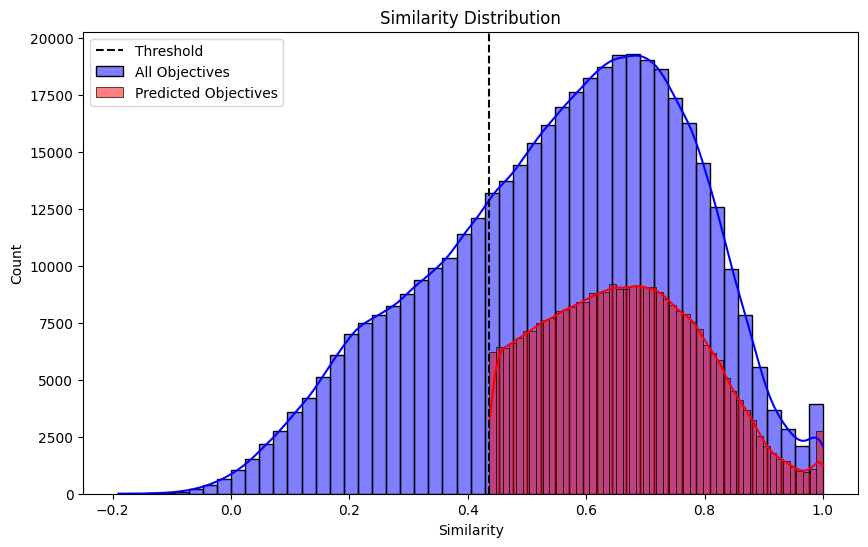

In [40]:
# plot predicted label per similarity threshold
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.histplot(df_preprocessed_all["similarity"], bins=50, color="blue", kde=True, label="All Objectives")
sns.histplot(df_preprocessed_all[df_preprocessed_all["predicted_label"] == 1]["similarity"], bins=50, color="red", kde=True, label="Predicted Objectives")
plt.axvline(final_thr, color="black", linestyle="--", label="Threshold")
plt.title("Similarity Distribution")
plt.xlabel("Similarity")
plt.ylabel("Count")
plt.legend()
plt.show()

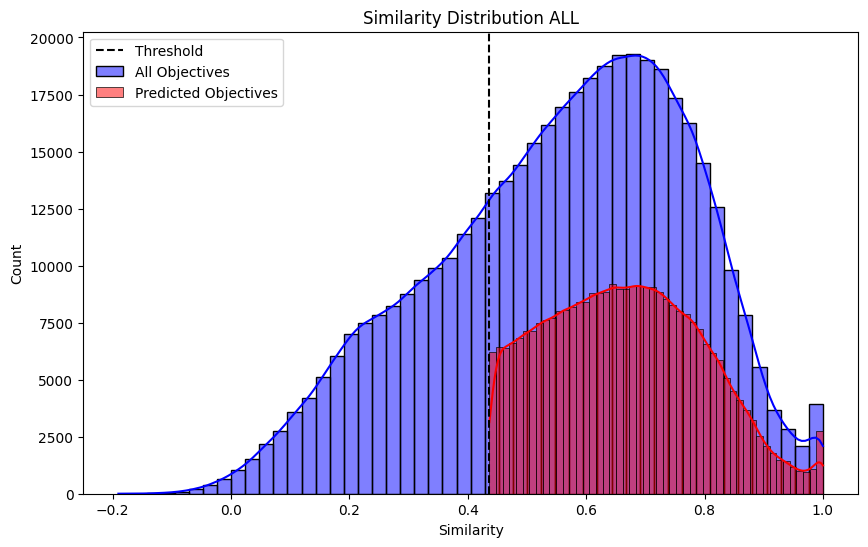

In [41]:
df_preprocessed_all_gencat = df_preprocessed_all[df_preprocessed_all["df_origin"] == "df_gencat"]

plt.figure(figsize=(10, 6))
sns.histplot(df_preprocessed_all_gencat["similarity"], bins=50, color="blue", kde=True, label="All Objectives")
sns.histplot(df_preprocessed_all_gencat[df_preprocessed_all_gencat["predicted_label"] == 1]["similarity"], bins=50, color="red", kde=True, label="Predicted Objectives")
plt.axvline(final_thr, color="black", linestyle="--", label="Threshold")
plt.title("Similarity Distribution ALL")
plt.xlabel("Similarity")
plt.ylabel("Count")
plt.legend()

In [42]:
df_preprocessed_all[df_preprocessed_all["df_origin"] == "zaragoza"].cpv

437209                            [45316100.0]
437210                            [55410000.0]
437211                [45316100.0, 31500000.0]
437212                            [79422000.0]
437213                            [71400000.0]
                          ...                 
437830                            [71317210.0]
437831                            [44921100.0]
437832    [90511100.0, 90511200.0, 90511300.0]
437833                [34928400.0, 45233293.0]
437834                [45316100.0, 45316000.0]
Name: cpv, Length: 626, dtype: object

In [43]:
print(f"With a threshold of {final_thr}, {df_preprocessed_all['predicted_label'].sum()} objectives are predicted as relevant out of {len(df_preprocessed_all)}")

With a threshold of 0.4364907985383816, 312625 objectives are predicted as relevant out of 437835


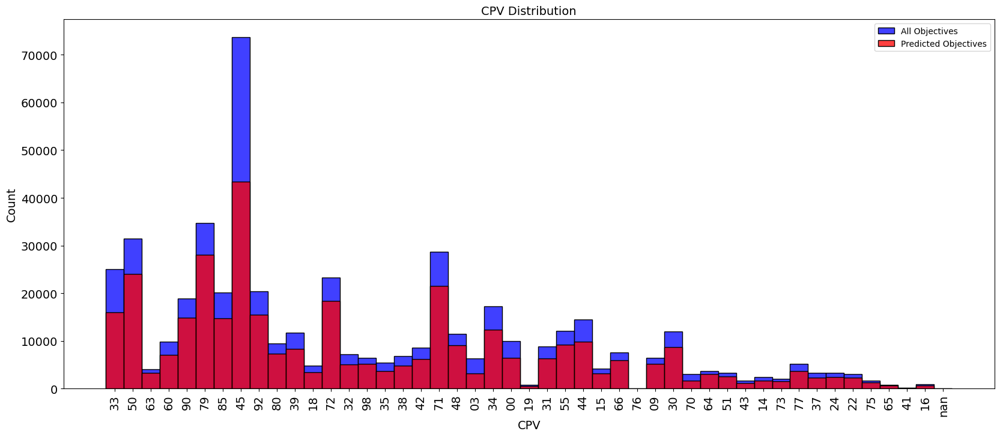

In [44]:
df_exploded = df_preprocessed_all[["id", "similarity", "two_cpv", "predicted_label"]].explode("two_cpv")

df_exploded["two_cpv"] = df_exploded["two_cpv"].astype(str)

#df_exploded = df_exploded.sort_values("two_cpv")

plt.figure(figsize=(20, 8))

sns.histplot(df_exploded["two_cpv"], color="blue", kde=False, label="All Objectives", discrete=True)
sns.histplot(df_exploded[df_exploded["predicted_label"] == 1]["two_cpv"], color="red", kde=False, label="Predicted Objectives", discrete=True)

predicted_counts = df_exploded[df_exploded["predicted_label"] == 1]["two_cpv"].value_counts()

#for i, (cpv, count) in enumerate(predicted_counts.items()):
#    plt.text(i, count + 2000, str(count), color='black', ha="center", fontsize=8, rotation=45)  

plt.title("CPV Distribution", fontsize=14)
plt.xlabel("CPV", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.xticks(rotation=90, fontsize=14) 
plt.yticks(fontsize=14)
plt.legend()

plt.show()

In [45]:
df_preprocessed_all_copy= df_preprocessed_all.loc[:, ~df_preprocessed_all.columns.duplicated()].copy()
df_preprocessed_all_copy["cpv"] = str(df_preprocessed_all_copy["cpv"])
df_preprocessed_all_copy

,id,df_origin,place_id,link,procurement_id,expediente,objective,orig_objective,title,lang_objective,similarity,origin,raw_text,lemmas,embeddings,date,cpv,raw_textc,two_cpv,predicted_label
0,0,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.asturias.es/portal/site/Asturias/me...,ntp00114200,NaN,El objeto del presente Pliego es la definición...,NaN,Suministro de Detector de Equipo de RX Portáti...,es,0.641474,out,El objeto del presente Pliego es la definición...,presente pliego prescripciones_técnicas sumini...,-0.24938826 -0.13601047 0.014062977 -0.1221755...,NaN,0 ...,NaN,[33],1
1,1,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp00729859,NaN,"El objeto del contrato, correspondiente a la p...",NaN,Prestación de Servicios de Explotación de los ...,es,0.247979,ins,"El objeto del contrato, correspondiente a la p...",presente mutual_midat cyclops_mutua colaborado...,-0.24115694 0.23295696 -0.29842922 -0.1423247 ...,NaN,0 ...,NaN,[50],0
2,2,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01335443,NaN,El objeto de estos pliegos es la definición de...,NaN,Servicio de gestión de las oficinas municipale...,es,0.657591,ins,El objeto de estos pliegos es la definición de...,específico servicio integral oficinas municipa...,0.0677057 -0.06575969 0.050962027 -0.046109743...,NaN,0 ...,NaN,[63],1
3,3,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.madrid.org/cs/Satellite?op2=PCON&id...,ntp00196761,NaN,El presente Pliego de Prescripciones tiene por...,NaN,Servicios por lotes para la conservación de vi...,es,0.567718,out,El presente Pliego de Prescripciones tiene por...,presente pliego prescripciones fijar servicio ...,-0.11525337 0.026284311 0.011863272 0.04002934...,NaN,0 ...,NaN,"[60, 90]",1
4,4,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01108524,NaN,Contratación del servicio de profesional de re...,NaN,Representación judicial y defensa jurídica en ...,es,0.870487,ins,Contratación del servicio de profesional de re...,servicio representación_procesal jurídico mutu...,-0.025360491 0.15327612 -0.12235839 -0.1584008...,NaN,0 ...,NaN,[79],1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437830,437830,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,NaN,0009891-23,contratar la asistencia técnica en materia de ...,Servicios de consultoría en materia de segurid...,Servicio de asistencia técnica en materia de s...,es,0.813420,ins,contratar la asistencia técnica en materia de ...,contratar materia mantenimiento servicio explo...,0.055627987 -0.10915607 0.14242853 -0.10648201...,2024-05-02,0 ...,"D Taragoza Ane de infraestructuras, vivienda Y...",[71],1
437831,437831,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,NaN,0027384-23,Suministro de Placas de cierre para las distin...,Suministro de placas de cierre para las distin...,Suministro de placas de cierre para el Cemente...,es,0.825017,ins,Suministro de Placas de cierre para las distin...,suministro placa entrenamiento cementerio muni...,0.2923369 0.093079574 0.035746865 -0.08493834 ...,2023-07-21,0 ...,que Zara goza servicio DE tNFoRMActóru v trénc...,[44],1
437832,437832,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,NaN,0093023-22,Es objeto de la presente licitación la convoca...,Explotación y mantenimiento integral del servi...,Explotación de las instalaciones de recogida n...,es,0.886649,ins,Es objeto de la presente licitación la convoca...,presente abierto explotación mantenimiento int...,-0.119490266 0.06951303 0.08492964 -0.01964369...,2023-04-25,0 ...,G es+ Taragoza Ayuno y Alto Servicio EL ESPACI...,[90],1
437833,437833,zaragoza,http

In [46]:
df_preprocessed_all_copy.to_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/processed_objectives_with_lemmas_emb_label.parquet")

In [47]:
path_cpv = "/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/cpv_predicted"
all_cpv = []
for file in os.listdir(path_cpv):
    if "zaragoza" not in file:
        path_ = (path_cpv + "/" + file)
        df_cpv = pd.read_json(path_)
        all_cpv.append(df_cpv)

df_cpv = pd.concat(all_cpv, ignore_index=True)
df_cpv

,procurement_id,objective,title,cpv_predicted_objective,cpv_predicted_title
0,ntp00114200,El objeto del presente Pliego es la definición...,Suministro de Detector de Equipo de RX Portáti...,33162.0,33140.0
1,ntp00729859,"El objeto del contrato, correspondiente a la p...",Prestación de Servicios de Explotación de los ...,85111.0,64210.0
2,ntp01335443,El objeto de estos pliegos es la definición de...,Servicio de gestión de las oficinas municipale...,79994.0,75120.0
3,ntp00196761,El presente Pliego de Prescripciones tiene por...,Servicios por lotes para la conservación de vi...,45453.0,77312.0
4,ntp01108524,Contratación del servicio de profesional de re...,Representación judicial y defensa jurídica en ...,79110.0,79111.0
...,...,...,...,...,...
437201,ntp00342450,El objeto de la licitación es el suministro di...,Subministrament d'aliments per als animals del...,15810.0,15120.0
437202,ntp00008722,Elaborar para cada una de las instalaciones un...,L'objecte del contracte és la prestació del se...,71521.0,90323.0
437203,ntp00299675,El objeto del contrato es la limpieza de las i...,"Servei de neteja de l'Institut Cavall Bernat, ...",90911.0,90911.0
437204,ntp00307454,"El objeto del contrato, en forma de lotes sepa...",La que es descriu al Plec de Prescripcions Tèc...,18300.0,22600.0


In [48]:
def extract_cpv_five(cpv):
    if pd.notna(cpv):
        cpv_clean = cpv[0].strip("[]")
        if len(cpv_clean.split(", ")) > 0:
            return list(set([el[:5] for el in cpv_clean.split(", ")]))
        else:
            return str(cpv_clean)[:5]
    return np.nan

In [50]:
# merge df_cpv with df_preprocessed_all to add the columns "cpv_predicted_objective" and "cpv_predicted_title" to the final dataframe
#df_preprocessed_all_cpv = df_preprocessed_all[["procurement_id", "cpv", "similarity"]].merge(df_cpv, how="left", on="procurement_id")
#df_preprocessed_all_cpv["five_cpv"] = df_preprocessed_all_cpv["cpv"].apply(extract_cpv_five)
#df_preprocessed_all_cpv["five_cpv"] = df_preprocessed_all_cpv["five_cpv"].apply(lambda x : x[0])
#df_preprocessed_all_cpv["cpv_predicted_objective"] = df_preprocessed_all_cpv["cpv_predicted_objective"].apply(lambda x: str(x).split(".")[0])
#df_preprocessed_all_cpv["cpv_predicted_title"] = df_preprocessed_all_cpv["cpv_predicted_title"].apply(lambda x: str(x).split(".")[0])

In [51]:
# plot similarity between "cpv_predicted_objective" and "cpv_predicted_title" (1 if match 0 otherwise) by similarity value
"""
df_preprocessed_all_cpv["match"] = (df_preprocessed_all_cpv["cpv_predicted_objective"] == df_preprocessed_all_cpv["cpv_predicted_title"]).astype(int)

plt.figure(figsize=(10, 6))
sns.histplot(df_preprocessed_all_cpv["similarity"], bins=50, color="blue", kde=True, label="All Objectives")
sns.histplot(df_preprocessed_all_cpv[df_preprocessed_all_cpv["match"] == 1]["similarity"], bins=50, color="red", kde=True, label="Match")
plt.axvline(final_thr, color="black", linestyle="--", label="Threshold")
plt.title("Inferred in title vs inferred in extracted objective")
plt.xlabel("Similarity")
plt.ylabel("Count")
plt.legend()
plt.show()
"""

'\ndf_preprocessed_all_cpv["match"] = (df_preprocessed_all_cpv["cpv_predicted_objective"] == df_preprocessed_all_cpv["cpv_predicted_title"]).astype(int)\n\nplt.figure(figsize=(10, 6))\nsns.histplot(df_preprocessed_all_cpv["similarity"], bins=50, color="blue", kde=True, label="All Objectives")\nsns.histplot(df_preprocessed_all_cpv[df_preprocessed_all_cpv["match"] == 1]["similarity"], bins=50, color="red", kde=True, label="Match")\nplt.axvline(final_thr, color="black", linestyle="--", label="Threshold")\nplt.title("Inferred in title vs inferred in extracted objective")\nplt.xlabel("Similarity")\nplt.ylabel("Count")\nplt.legend()\nplt.show()\n'

### Create final partitions per CPV

In [62]:
import pandas as pd

df = pd.read_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/processed_objectives_with_lemmas_emb_label.parquet")
#df = df_preprocessed_all_copy.copy()
df

,id,df_origin,place_id,link,procurement_id,expediente,objective,orig_objective,title,lang_objective,similarity,origin,raw_text,lemmas,embeddings,date,cpv,raw_textc,two_cpv,predicted_label
0,0,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.asturias.es/portal/site/Asturias/me...,ntp00114200,None,El objeto del presente Pliego es la definición...,None,Suministro de Detector de Equipo de RX Portáti...,es,0.641474,out,El objeto del presente Pliego es la definición...,presente pliego prescripciones_técnicas sumini...,-0.24938826 -0.13601047 0.014062977 -0.1221755...,None,0 ...,None,[33],1
1,1,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp00729859,None,"El objeto del contrato, correspondiente a la p...",None,Prestación de Servicios de Explotación de los ...,es,0.247979,ins,"El objeto del contrato, correspondiente a la p...",presente mutual_midat cyclops_mutua colaborado...,-0.24115694 0.23295696 -0.29842922 -0.1423247 ...,None,0 ...,None,[50],0
2,2,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01335443,None,El objeto de estos pliegos es la definición de...,None,Servicio de gestión de las oficinas municipale...,es,0.657591,ins,El objeto de estos pliegos es la definición de...,específico servicio integral oficinas municipa...,0.0677057 -0.06575969 0.050962027 -0.046109743...,None,0 ...,None,[63],1
3,3,df_gencat,https://contrataciondelestado.es/sindicacion/P...,http://www.madrid.org/cs/Satellite?op2=PCON&id...,ntp00196761,None,El presente Pliego de Prescripciones tiene por...,None,Servicios por lotes para la conservación de vi...,es,0.567718,out,El presente Pliego de Prescripciones tiene por...,presente pliego prescripciones fijar servicio ...,-0.11525337 0.026284311 0.011863272 0.04002934...,None,0 ...,None,"[60, 90]",1
4,4,df_gencat,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,ntp01108524,None,Contratación del servicio de profesional de re...,None,Representación judicial y defensa jurídica en ...,es,0.870487,ins,Contratación del servicio de profesional de re...,servicio representación_procesal jurídico mutu...,-0.025360491 0.15327612 -0.12235839 -0.1584008...,None,0 ...,None,[79],1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437830,437830,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,None,0009891-23,contratar la asistencia técnica en materia de ...,Servicios de consultoría en materia de segurid...,Servicio de asistencia técnica en materia de s...,es,0.813420,ins,contratar la asistencia técnica en materia de ...,contratar materia mantenimiento servicio explo...,0.055627987 -0.10915607 0.14242853 -0.10648201...,2024-05-02,0 ...,"D Taragoza Ane de infraestructuras, vivienda Y...",[71],1
437831,437831,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,None,0027384-23,Suministro de Placas de cierre para las distin...,Suministro de placas de cierre para las distin...,Suministro de placas de cierre para el Cemente...,es,0.825017,ins,Suministro de Placas de cierre para las distin...,suministro placa entrenamiento cementerio muni...,0.2923369 0.093079574 0.035746865 -0.08493834 ...,2023-07-21,0 ...,que Zara goza servicio DE tNFoRMActóru v trénc...,[44],1
437832,437832,zaragoza,https://contrataciondelestado.es/sindicacion/l...,https://contrataciondelestado.es/wps/poc?uri=d...,None,0093023-22,Es objeto de la presente licitación la convoca...,Explotación y mantenimiento integral del servi...,Explotación de las instalaciones de recogida n...,es,0.886649,ins,Es objeto de la presente licitación la convoca...,presente abierto explotación mantenimiento int...,-0.119490266 0.06951303 0.08492964 -0.01964369...,2023-04-25,0 ...,G es+ Taragoza Ayuno y Alto Servicio EL ESPACI...,[90],1
4378

In [63]:
# filter duplicates by place_id keeping the one with the highest similarity
df = df.sort_values("similarity", ascending=False).drop_duplicates(subset=["place_id"], keep="first")
len(df)

360028

In [64]:
# keep rows where predicted_label is 1
print(f"Before filtering predicted_label == 1: {df.shape}")
df = df[df["predicted_label"] == 1]
print(f"After filtering predicted_label == 1: {df.shape}")

Before filtering predicted_label == 1: (360028, 20)
After filtering predicted_label == 1: (258362, 20)


In [65]:
# drop nan in "two_cpv"
print(f"Before dropping NaN in 'two_cpv': {df.shape}")
df = df.dropna(subset=["two_cpv"])
print(f"After dropping NaN in 'two_cpv': {df.shape}")

Before dropping NaN in 'two_cpv': (258362, 20)
After dropping NaN in 'two_cpv': (258361, 20)


In [66]:
# Complete dataset
df = df.drop(columns=["cpv"])
df_exploded = df.explode("two_cpv")
#df_exploded = df_exploded[["place_id", "two_cpv", "lemmas"]]
df_exploded = df_exploded[(df_exploded.two_cpv != 'nan') & (df_exploded.two_cpv != 'na')]
#df_exploded[
#    ['id', 'df_origin', 'place_id', 'link', 'procurement_id', 'similarity', 'raw_text', 'lemmas', 'two_cpv', 'predicted_label']
#    ].to_parquet("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/data_per_cpv_with_labels.parquet")

In [57]:
df_exploded.columns

Index(['id', 'df_origin', 'place_id', 'link', 'procurement_id', 'expediente',
       'objective', 'orig_objective', 'title', 'lang_objective', 'similarity',
       'origin', 'raw_text', 'lemmas', 'embeddings', 'date', 'raw_textc',
       'two_cpv', 'predicted_label'],
      dtype='object')

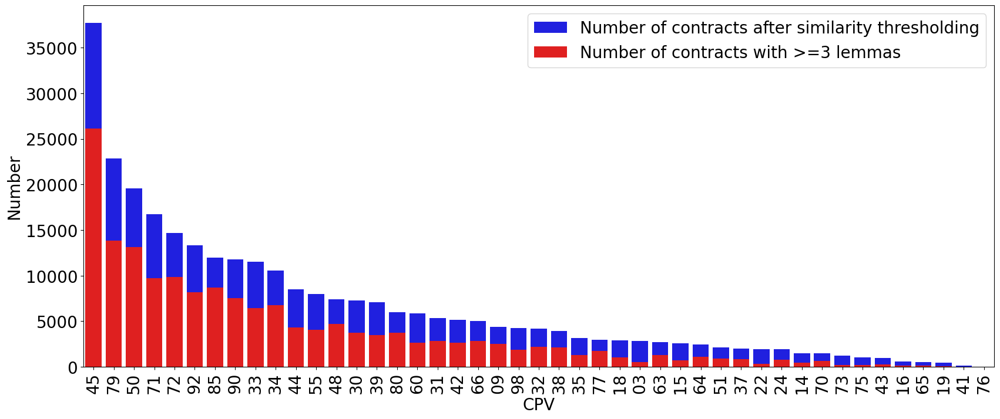

In [75]:
# histogram of number of objectives per CPV sorted by count
import matplotlib.pyplot as plt
import seaborn as sns

#sorted_cpv = df_exploded["two_cpv"].value_counts().sort_values(ascending=False)
# read parquets in output_dir = "/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/training_dfs_per_cpv/" and concatenate them
output_dir = "/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/training_dfs_per_cpv/"
dfs = []
for file in os.listdir(output_dir):
    if file.endswith(".parquet"):
        df = pd.read_parquet(os.path.join(output_dir, file))
        dfs.append(df)
dfs = pd.concat(dfs, ignore_index=True)
sorted_cpv = dfs["two_cpv"].value_counts().sort_values(ascending=False)


kept = pd.read_csv("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/count_per_cpv.csv")
# sort kept by "# count"
kept = kept.sort_values("count", ascending=False)
# convert "3" to "03" and "9" to "09"
kept["cpv"] = kept["cpv"].apply(lambda x: x if len(str(x)) == 2 else "0" + str(x))

# drop if "cpv" is 00
#kept = kept[kept["cpv"] != "00"]
# drop if "cpv" is 00
#sorted_cpv = sorted_cpv[sorted_cpv.index != "00"]

# plot sorted CPV
plt.figure(figsize=(20, 8))
sns.barplot(x=sorted_cpv.index, y=sorted_cpv.values, color="blue", label="Number of contracts after similarity thresholding")
sns.barplot(x=kept["cpv"], y=kept["count"], color="red", label="Number of contracts with >=3 lemmas")
#lt.title("Número de objetos por CPV")
plt.xlabel("CPV", fontsize=20)
plt.ylabel("Number", fontsize=20)
plt.xticks(rotation=90, fontsize=20)
plt.yticks(fontsize=20)
plt.legend(fontsize=20)
plt.show()

In [ ]:
kept = pd.read_csv("/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/count_per_cpv.csv")
kept

,cpv,count
0,55,4036
1,37,841
2,34,6785
3,98,1880
4,79,13824
5,16,143
6,33,6459
7,80,3739
8,65,131
9,48,4719


## Crate Zaragoza training data

In [ ]:
output_dir = "/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/training_df_zaragoza/"
os.makedirs(output_dir, exist_ok=True)  # Ensure the directory exists

df_zara_ones = df[df["df_origin"] == "zaragoza"]
df_zara_ones.to_parquet(output_dir + "df_zara_ones.parquet")

In [ ]:
df = df.drop(columns=["cpv"])
df_exploded = df.explode("two_cpv")
df_exploded = df_exploded[["place_id", "two_cpv", "lemmas"]]
df_exploded = df_exploded[(df_exploded.two_cpv != 'nan') & (df_exploded.two_cpv != 'na')]
df_exploded

,place_id,two_cpv,lemmas
121305,https://contrataciondelestado.es/sindicacion/l...,39,suministro equipamiento centro primaria_secund...
301781,https://contrataciondelestado.es/sindicacion/l...,98,presente pliego sujetar él servicio auxiliar a...
328919,https://contrataciondelestado.es/sindicacion/d...,92,servicio vídeo personalidad galardonado motivo...
29360,https://contrataciondelestado.es/sindicacion/l...,30,adquisición mobiliario oficina material inform...
29360,https://contrataciondelestado.es/sindicacion/l...,39,adquisición mobiliario oficina material inform...
...,...,...,...
437669,https://contrataciondelestado.es/sindicacion/l...,34,régimen_arrendamiento mantenimiento elemento h...
437677,https://contrataciondelestado.es/sindicacion/l...,79,presente servicio diseño sede_electrónica ayun...
437682,https://contrataciondelestado.es/sindicacion/l...,92,presente servicio socorrismo temporada centros...
437738,https://contrataciondelestado.es/sindicacion/l...,72,identificar módulo independiente agradabilidad...


In [ ]:
df_exploded["len_lemmas"] = df_exploded["lemmas"].apply(lambda x: len(x))
df_exploded["len_lemmas"].describe()

count    288859.000000
mean        109.226817
std          35.485820
min           0.000000
25%          84.000000
50%         110.000000
75%         134.000000
max         590.000000
Name: len_lemmas, dtype: float64

In [ ]:
df_exploded[df_exploded["len_lemmas"] < 3]

,place_id,two_cpv,lemmas,len_lemmas
228754,https://contrataciondelestado.es/sindicacion/d...,79,,0
334571,https://contrataciondelestado.es/sindicacion/d...,34,mm,2
78165,https://contrataciondelestado.es/sindicacion/d...,00,,0
359314,https://contrataciondelestado.es/sindicacion/l...,00,,0
174355,https://contrataciondelestado.es/sindicacion/l...,45,,0
257161,https://contrataciondelestado.es/sindicacion/l...,03,,0
101412,https://contrataciondelestado.es/sindicacion/d...,80,,0
354630,https://contrataciondelestado.es/sindicacion/l...,70,,0
287204,https://contrataciondelestado.es/sindicacion/l...,45,,0
47680,https://contrataciondelestado.es/sindicacion/l...,66,,0


In [ ]:
place_ids_check = df_exploded[df_exploded["len_lemmas"] == 0]["place_id"].unique()

In [ ]:
df[df["place_id"].isin(place_ids_check)]

,id,df_origin,place_id,link,procurement_id,expediente,objective,orig_objective,title,lang_objective,similarity,origin,raw_text,lemmas,embeddings,date,raw_textc,two_cpv,predicted_label
228754,228754,df_gencat,https://contrataciondelestado.es/sindicacion/d...,<NA>,ntp11577492,NaN,El objeto del contrato es la elaboración de un...,NaN,Estudio sobre la digitalización de las empresa...,es,0.796213,min,El objeto del contrato es la elaboración de un...,,-0.0020214552 -0.0005487329 -0.033084027 -0.05...,NaN,NaN,[79],1
78165,78165,df_gencat,https://contrataciondelestado.es/sindicacion/d...,<NA>,ntp11373364,NaN,Necesidad de una política de la tierra.,NaN,Contrato en exclusiva para presentación del li...,es,0.658431,min,Necesidad de una política de la tierra.,,-0.03619942 0.066986166 0.005096965 0.00423807...,NaN,NaN,[00],1
359314,359314,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00563187,NaN,Aprovechamiento de pastos para ganado.,NaN,arrendamiento de pastos,es,0.646664,ins,Aprovechamiento de pastos para ganado.,,-0.008845494 0.062841535 -0.018530253 -0.01696...,NaN,NaN,[00],1
174355,174355,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00507813,NaN,Determinar las obras a realizar en algunas dep...,NaN,Acondicionamiento de Espacios en Casa de Cultu...,es,0.642746,ins,Determinar las obras a realizar en algunas dep...,,-0.036848128 0.053914033 -0.015863655 0.007059...,NaN,NaN,[45],1
257161,257161,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00737699,NaN,Realización de una corta de mejora en masa de ...,NaN,Aprovechamiento de madera del monte número 303...,es,0.628508,ins,Realización de una corta de mejora en masa de ...,,-0.063379765 -0.021867583 -0.0021218145 -0.012...,NaN,NaN,[34],1
101412,101412,df_gencat,https://contrataciondelestado.es/sindicacion/d...,<NA>,ntp11248961,NaN,"Elaboración de pliegos, adjudicación y ejecuci...",NaN,Curso de Contratación Pública.,es,0.613884,min,"Elaboración de pliegos, adjudicación y ejecuci...",,0.016754545 -0.03132914 0.01043707 -0.03589638...,NaN,NaN,[80],1
354630,354630,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00986597,NaN,Solar urbano. Solar urbano.,NaN,Arrendamiento de 2 solares calle Federico Garc...,it,0.600428,ins,Solar urbano. Solar urbano.,,-0.017247286 0.06138686 -0.010772871 -0.033036...,NaN,NaN,[70],1
287204,287204,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00974924,NaN,El objeto de esta propuesta es la contratación...,NaN,Realización de las obras comprendidas en el pr...,es,0.531696,ins,El objeto de esta propuesta es la contratación...,,0.0142192105 0.02952635 0.005733342 -0.0208241...,NaN,NaN,[45],1
47680,47680,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00496531,NaN,El objeto de este pliego determinar las condic...,NaN,Contratación pólizas de seguro para cobertura ...,es,0.501618,ins,El objeto de este pliego determinar las condic...,,0.0019414338 -0.04459264 0.0071282205 -0.01688...,NaN,NaN,[66],1
42791,42791,df_gencat,https://contrataciondelestado.es/sindicacion/l...,<NA>,ntp00475385,NaN,Es objeto de este pliego determinar las condic...,NaN,Contratación pólizas de seguro para cobertura ...,es,0.482284,ins,Es objeto de este pliego determinar las condic...,,0.0016794254 -0.025214024 0.005935296 -0.00785...,NaN,NaN,[66],1


In [ ]:
"""
df_exploded[df_exploded.two_cpv == "93"]

# the "two_cpv" of rows with "two_cpv" == "93" or "91" are not "93" or "91" but "09"
df_exploded["two_cpv"] = df_exploded["two_cpv"].replace({"91": "09", "93": "09"})
df_exploded["two_cpv"].value_counts()
"""

'\ndf_exploded[df_exploded.two_cpv == "93"]\n\n# the "two_cpv" of rows with "two_cpv" == "93" or "91" are not "93" or "91" but "09"\ndf_exploded["two_cpv"] = df_exploded["two_cpv"].replace({"91": "09", "93": "09"})\ndf_exploded["two_cpv"].value_counts()\n'

In [ ]:
# groupby "two_cpv", count the number of objectives and save each partition in a different file sorted from the most to the least common. Files should be name as "{id}_{cpv}.parquet" where "id" is the number of the partition (starting from 0) and "cpv" is the cpv code.
import os
import re

output_dir = "/export/usuarios_ml4ds/lbartolome/NextProcurement/NP-Text_Object/data/train_data/training_dfs_per_cpv/"
os.makedirs(output_dir, exist_ok=True)  # Ensure the directory exists

df_grouped = df_exploded.groupby("two_cpv").size().reset_index(name="count").sort_values("count", ascending=False)
df_grouped = df_grouped.reset_index(drop=True)
grouped_df = df.groupby("two_cpv")

grouped_df = df.groupby("two_cpv")

cpvs = []
for i, row in df_grouped.iterrows():
    cpv = str(row["two_cpv"])
    cpvs.append(cpv)
    df_cpv = df_exploded[df_exploded["two_cpv"] == cpv]
    print(f"Saving {len(df_cpv)} objectives for CPV {cpv} in file {i}_{cpv}.parquet")
    df_cpv.to_parquet(os.path.join(output_dir, f"{i}_{cpv}.parquet"))

Saving 37738 objectives for CPV 45 in file 0_45.parquet
Saving 22851 objectives for CPV 79 in file 1_79.parquet
Saving 19567 objectives for CPV 50 in file 2_50.parquet
Saving 16748 objectives for CPV 71 in file 3_71.parquet
Saving 14680 objectives for CPV 72 in file 4_72.parquet
Saving 13330 objectives for CPV 92 in file 5_92.parquet
Saving 11964 objectives for CPV 85 in file 6_85.parquet
Saving 11783 objectives for CPV 90 in file 7_90.parquet
Saving 11526 objectives for CPV 33 in file 8_33.parquet
Saving 10532 objectives for CPV 34 in file 9_34.parquet
Saving 8536 objectives for CPV 44 in file 10_44.parquet
Saving 7961 objectives for CPV 55 in file 11_55.parquet
Saving 7440 objectives for CPV 48 in file 12_48.parquet
Saving 7284 objectives for CPV 30 in file 13_30.parquet
Saving 7090 objectives for CPV 39 in file 14_39.parquet
Saving 6001 objectives for CPV 80 in file 15_80.parquet
Saving 5874 objectives for CPV 60 in file 16_60.parquet
Saving 5343 objectives for CPV 31 in file 17_31.

In [ ]:
# create dictionary with the cpvs as keys and empty values
cpv_dict = {cpv: "" for cpv in cpvs}
cpv_dict

{'45': '',
 '79': '',
 '50': '',
 '71': '',
 '72': '',
 '92': '',
 '85': '',
 '90': '',
 '33': '',
 '34': '',
 '44': '',
 '55': '',
 '48': '',
 '30': '',
 '39': '',
 '80': '',
 '60': '',
 '31': '',
 '42': '',
 '66': '',
 '09': '',
 '98': '',
 '32': '',
 '38': '',
 '35': '',
 '77': '',
 '18': '',
 '03': '',
 '63': '',
 '15': '',
 '64': '',
 '51': '',
 '37': '',
 '22': '',
 '24': '',
 '14': '',
 '70': '',
 '73': '',
 '75': '',
 '43': '',
 '16': '',
 '65': '',
 '19': '',
 '41': '',
 '76': ''}